### Load datasets

In [1]:
import pandas as pd

# Load the datasets into single dataframe
df1 = pd.read_csv('data/dad-a-base.csv')
df2 = pd.read_csv('data/reddit_dadjokes.csv')
df3 = pd.read_csv('data/shortjokes.csv')

df = pd.concat([df1['Joke'], df2['joke'], df3['Joke']], ignore_index=True)
df = pd.DataFrame(df, columns=['joke'])


In [2]:
# Define keywords related to data science
keywords = ['data', 'algorithm', 'computer', 'code', 'math', 'statistics', 'machine', 'analytics', 'algorithm', 'python', 'visualization', 'engineer', 'scientist', 'nlp', 'gpt']

# Filter jokes based on keywords (441727 -> 7516)
df_filtered = df[df['joke'].str.contains('|'.join(keywords), case=False, na=False)]

In [3]:
df_filtered.head()

,joke
44,It was so cold yesterday my computer froze. My...
209,What do computers and air conditioners have in...
211,Scientists finally did a study on forks. It's ...
302,Did you hear about the scientist who was lab p...
363,"There are two types of people in this world, t..."


In [4]:
"""
Cell generated by Data Wrangler.
"""
def clean_data(df_filtered):
    # Drop duplicate rows across all columns
    df_filtered.drop_duplicates(inplace=True)
    return df_filtered

df_filtered_clean = clean_data(df_filtered.copy())
df_filtered_clean.head()

,joke
44,It was so cold yesterday my computer froze. My...
209,What do computers and air conditioners have in...
211,Scientists finally did a study on forks. It's ...
302,Did you hear about the scientist who was lab p...
363,"There are two types of people in this world, t..."


In [5]:
df_filtered.describe()

,joke
count,7609
unique,7518
top,Did you hear about the constipated mathematici...
freq,6


### Visualization and widgeting

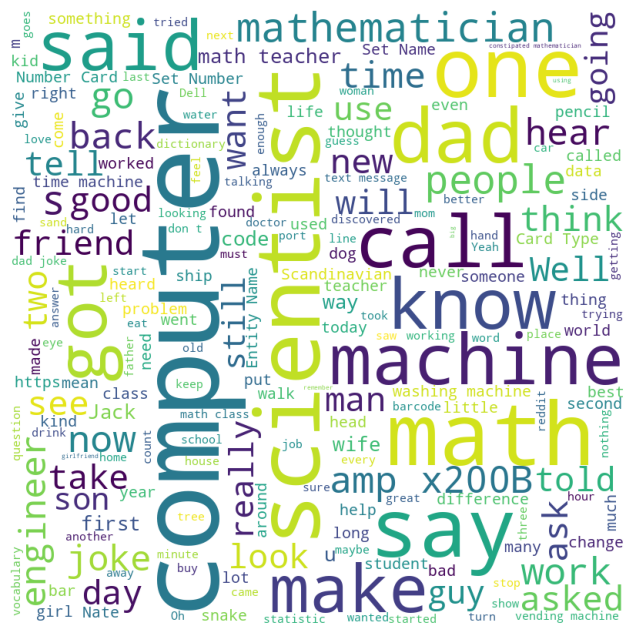

In [6]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Generate the word cloud
wordcloud = WordCloud(width=800, height=800, background_color='white').generate(' '.join(df_filtered['joke']))

# Display the word cloud
plt.figure(figsize=(8,8))
plt.imshow(wordcloud)
plt.axis('off')


In [7]:
import plotly.express as px
from collections import defaultdict

# Create a dictionary to store words and their corresponding jokes
word_to_jokes = defaultdict(list)
for joke in df_filtered['joke']:
    for word in joke.split():
        word_to_jokes[word].append(joke)

# Create a DataFrame for plotting
plot_data = pd.DataFrame(wordcloud.words_.items(), columns=['word', 'freq'])
plot_data['joke'] = plot_data['word'].map(lambda x: '\n'.join(word_to_jokes[x]))

# Create an interactive scatter plot (word cloud) for top 10 frequent words
top_10 = plot_data.nlargest(10, 'freq')
fig = px.scatter(top_10, x='word', y='freq', text='word', size='freq', hover_data=['joke'])
fig.update_traces(textposition='top center', textfont_size=14)
fig.update_layout(showlegend=False, xaxis_visible=False, yaxis_visible=False)
fig.show()

In [8]:
import ipywidgets as widgets
from IPython.display import display

# Create an output widget to display the joke
joke_output = widgets.Output()

# Define a function to output a random joke
def output_random_joke(button):
    joke_output.clear_output()
    with joke_output:
        random_joke = df_filtered['joke'].sample(n=1).item()
        print(random_joke)

# Create a button widget
joke_button = widgets.Button(description='Tell me a joke!')

# Attach the function to the button widget
joke_button.on_click(output_random_joke)

# Display the button widget
display(joke_button)
display(joke_output)

Button(description='Tell me a joke!', style=ButtonStyle())

Output()

### Generate jokes using GPT2

In [9]:
from transformers import GPT2Tokenizer, GPT2LMHeadModel, Trainer, TrainingArguments

tokenizer = GPT2Tokenizer.from_pretrained('gpt2', padding_side='left')
model = GPT2LMHeadModel.from_pretrained('gpt2')

# Resize the model's embeddings to match the tokenizer's vocabulary size
model.resize_token_embeddings(len(tokenizer))

Embedding(50257, 768)

Generate a joke using a prompt

In [12]:
import torch

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

# Move the model and input tensors to the target device
model = model.to(device)


cuda


In [10]:
prompt = "Here is a joke"

joke_input = tokenizer.encode_plus(prompt, return_tensors='pt', add_special_tokens=True)
joke_input = {key: value.to(device) for key, value in joke_input.items()}

In [13]:
# Extract input_ids and attention_mask from the inputs dictionary
joke_input_ids = joke_input['input_ids']
joke_attention_mask = joke_input['attention_mask']

In [16]:
# Generate a response using the model
output = model.generate(
    input_ids=joke_input_ids,
    attention_mask=joke_attention_mask,
    max_length=50,  # Maximum length of the generated response
    num_return_sequences=1,  # Number of responses to generate
    no_repeat_ngram_size=2,  # Prevent repeating n-grams
    do_sample=True,  # Sampling instead of greedy decoding
    temperature=0.7,  # Temperature for sampling,
    pad_token_id=tokenizer.eos_token_id,
)

# Decode the generated response
generated_text = tokenizer.decode(output[0], skip_special_tokens=True)

# Print the generated response
print(generated_text)

Here is a joke from the '50s, circa 1980:

A man on the street in a black van walks by. He sees a man dressed like a policeman, and tells him to get out of the car and go home. The


Generate random jokes / responses

In [19]:
# Get the beginning-of-sentence (BOS) token ID to generate random outputs without providing any specific input 
bos_token_id = tokenizer.bos_token_id

# Create input tensor with only the BOS token ID
rand_input_ids = torch.tensor([[bos_token_id]]).to(device)

# Create attention mask with the same shape as input_ids and filled with ones
attention_mask = torch.ones_like(rand_input_ids)

# Generate multiple random responses using the model
num_samples = 3  # Number of random outputs to generate
output = model.generate(
    input_ids=rand_input_ids,
    max_length=50,  # Maximum length of the generated response
    num_return_sequences=num_samples,  # Number of responses to generate
    no_repeat_ngram_size=2,  # Prevent repeating n-grams
    do_sample=True,  # Sampling instead of greedy decoding
    temperature=0.7,  # Temperature for sampling,
    pad_token_id=tokenizer.eos_token_id,
)

# Decode and print each generated response
for i, response in enumerate(output):
    generated_text = tokenizer.decode(response, skip_special_tokens=True)
    print(f"Sample {i + 1}: {generated_text}")
    print()

A decoder-only architecture is being used, but right-padding was detected! For correct generation results, please set `padding_side='left'` when initializing the tokenizer.


Sample 1: I think the whole point of the first season of Star Trek is to make the show more interesting than it is. And I think that's where the writers want to go.

"The thing that I wanted to do is have as many

Sample 2: When a person is assaulted with a gun, he or she will often be asked to surrender their rights to life, liberty, and property. The law would be wise to require that a man surrender his or her right to possess firearms, so long

Sample 3: 2.2 1

2



1.5 2

.3 1.7

...







### Finetuning the model with dataset

In [20]:
from datasets import Dataset

# Convert the jokes column into a Hugging Face Dataset object
jokes_dataset = Dataset.from_pandas(df_filtered[['joke']])
jokes_dataset = jokes_dataset.rename_column('joke', 'text')

In [21]:
# Tokenize the dataset
tokenizer.pad_token = tokenizer.eos_token

def tokenize_function(examples):
    tokenized = tokenizer(examples["text"], padding="max_length", truncation=True, max_length=128)
    labels = []
    for input_ids in tokenized["input_ids"]:
        label = input_ids.copy()
        label[:-1] = input_ids[1:]
        label[-1] = -100
        labels.append(label)
    tokenized["labels"] = labels
    return tokenized

tokenized_jokes_dataset = jokes_dataset.map(tokenize_function, batched=True)

# Prepare the dataset for training
tokenized_jokes_dataset.set_format("torch", columns=["input_ids", "attention_mask", "labels"])

Map:   0%|          | 0/7609 [00:00<?, ? examples/s]

In [22]:
# Prepare the dataset for training
tokenized_jokes_dataset.set_format("torch", columns=["input_ids", "attention_mask", "labels"])


In [23]:
# Configure arguments for the training process
training_args = TrainingArguments(
    output_dir='./results',          # Output directory for model checkpoints
    num_train_epochs=3,              # Number of training epochs
    per_device_train_batch_size=8,   # Batch size per device during training
    logging_dir='./logs',            # Directory for storing logs
    logging_steps=100,               # Log every X steps
    save_steps=500,                  # Save checkpoint every X steps
    warmup_steps=100,                # Number of warmup steps for learning rate scheduler
    weight_decay=0.01,               # Weight decay if we apply some
    evaluation_strategy='no',        # Evaluation strategy (can be 'epoch' or 'steps')
)


In [24]:
# Create a Trainer instance
trainer = Trainer(
    model=model,                     # The GPT-2 model to be fine-tuned
    args=training_args,              # Training arguments
    train_dataset=tokenized_jokes_dataset,  # The tokenized dataset to be used for training
)

In [29]:
# Fine-tune the model
trainer.train()

Step,Training Loss


TrainOutput(global_step=2856, training_loss=1.7475586551912023, metrics={'train_runtime': 326.854, 'train_samples_per_second': 69.839, 'train_steps_per_second': 8.738, 'total_flos': 1491128303616000.0, 'train_loss': 1.7475586551912023, 'epoch': 3.0})

In [46]:
checkpoint_dir = './results/checkpoint-500'

ft_model = GPT2LMHeadModel.from_pretrained(checkpoint_dir)

# Resize the model's embeddings to match the tokenizer's vocabulary size
ft_model.resize_token_embeddings(len(tokenizer))

# Move the finetuned model to the target device
ft_model = ft_model.to(device)

In [47]:
output_sequences = ft_model.generate(
    input_ids=joke_input_ids,
    attention_mask=joke_attention_mask,
    max_length=50,  # Maximum length of the generated response
    num_return_sequences=1,  # Number of responses to generate
    no_repeat_ngram_size=2,  # Prevent repeating n-grams
    do_sample=True,  # Sampling instead of greedy decoding
    temperature=0.7,  # Temperature for sampling,
    pad_token_id=tokenizer.eos_token_id,
)

# Decode the generated text
generated_text = tokenizer.decode(output_sequences[0], skip_special_tokens=True)
# generated_text = tokenizer.decode(output[0], skip_special_tokens=True)

# Print the generated text
print(generated_text)

Here is a joke I 


In [48]:
# Get the beginning-of-sentence (BOS) token ID to generate random outputs without providing any specific input 
bos_token_id = tokenizer.bos_token_id

# Create input tensor with only the BOS token ID
rand_input_ids = torch.tensor([[bos_token_id]]).to(device)

# Create attention mask with the same shape as input_ids and filled with ones
attention_mask = torch.ones_like(rand_input_ids)

# Generate multiple random responses using the model
num_samples = 3  # Number of random outputs to generate
output = ft_model.generate(
    input_ids=rand_input_ids,
    max_length=50,  # Maximum length of the generated response
    num_return_sequences=num_samples,  # Number of responses to generate
    no_repeat_ngram_size=2,  # Prevent repeating n-grams
    do_sample=True,  # Sampling instead of greedy decoding
    temperature=0.7,  # Temperature for sampling,
    pad_token_id=tokenizer.eos_token_id,
)

# Decode and print each generated response
for i, response in enumerate(output):
    generated_text = tokenizer.decode(response, skip_special_tokens=True)
    print(f"Sample {i + 1}: {generated_text}")
    print()

A decoder-only architecture is being used, but right-padding was detected! For correct generation results, please set `padding_side='left'` when initializing the tokenizer.


Sample 1: 

Sample 2: 

Sample 3: 



In [49]:
# Get the beginning-of-sentence (BOS) token ID to generate random outputs without providing any specific input 
bos_token_id = tokenizer.bos_token_id

# Create input tensor with only the BOS token ID
rand_input_ids = torch.tensor([[bos_token_id]]).to(device)

# Create attention mask with the same shape as input_ids and filled with ones
attention_mask = torch.ones_like(rand_input_ids)

# Generate multiple random responses using the model
num_samples = 3  # Number of random outputs to generate
output = model.generate(
    input_ids=rand_input_ids,
    max_length=50,  # Maximum length of the generated response
    num_return_sequences=num_samples,  # Number of responses to generate
    no_repeat_ngram_size=2,  # Prevent repeating n-grams
    do_sample=True,  # Sampling instead of greedy decoding
    temperature=0.7,  # Temperature for sampling,
    pad_token_id=tokenizer.eos_token_id,
)

# Decode and print each generated response
for i, response in enumerate(output):
    generated_text = tokenizer.decode(response, skip_special_tokens=True)
    print(f"Sample {i + 1}: {generated_text}")
    print()

A decoder-only architecture is being used, but right-padding was detected! For correct generation results, please set `padding_side='left'` when initializing the tokenizer.


Sample 1: 

Sample 2: I

Sample 3: .



In [38]:
# Save the fine-tuned model
model.save_pretrained('./ft_model')